<a href="https://colab.research.google.com/github/AndSiq97/COVID-19-Healthy-Diet/blob/master/Food_Supply_(in_kcal)_Quantity_COVID_19_Health_Diet_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib 
import seaborn as sns
import os
%matplotlib inline
import matplotlib.style as style

In [2]:
# Uncomment this cell, Run this, comment cell, restart runtime and run everything else
# !pip install --upgrade matplotlib

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

os.environ['KAGGLE_CONFIG_DIR'] = "/content/gdrive/My Drive/Kaggle"
# /content/gdrive/My Drive/Kaggle is the path where kaggle.json is present in the Google Drive

#changing the working directory
%cd /content/gdrive/My Drive/Kaggle
#Check the present working directory using pwd command

Mounted at /content/gdrive
/content/gdrive/My Drive/Kaggle


Load Datasets

In [4]:
# Reading some csv files
food_supply_kcal_data = pd.read_csv("/content/gdrive/MyDrive/Food_Supply_kcal_Data.csv")
supply_food_descriptions_data = pd.read_csv("/content/gdrive/MyDrive/Supply_Food_Data_Descriptions.csv")

Food Supply Descriptions Data

In [5]:
# Checking first 5 rows of Supply Food Descriptions dataframe
supply_food_descriptions_data.head()

,Categories,Items
0,Alcoholic Beverages,"Alcohol, Non-Food; Beer; Beverages, Alcoholic;..."
1,Animal fats,"Butter, Ghee; Cream; Fats, Animals, Raw; Fish,..."
2,Animal Products,"Aquatic Animals, Others; Aquatic Plants; Bovin..."
3,"Aquatic Products, Other","Aquatic Animals, Others; Aquatic Plants; Meat,..."
4,Cereals - Excluding Beer,"Barley and products; Cereals, Other; Maize and..."


Food Supply Quantity (in kcal) Data

In [7]:
# Checking first 5 rows of Food Supply Quantity (in kcal) dataframe
food_supply_kcal_data.head()

,Country,Alcoholic Beverages,Animal Products,Animal fats,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Milk - Excluding Butter,Miscellaneous,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar Crops,Sugar & Sweeteners,Treenuts,Vegetal Products,Vegetable Oils,Vegetables,Obesity,Undernourished,Confirmed,Deaths,Recovered,Active,Population,Unit (all except Population)
0,Afghanistan,0.0000,4.7774,0.8504,0.0,37.1186,0.1501,0.0000,1.4757,1.2006,2.4512,0.0250,0.1251,0.1751,0.5003,0.1001,0.3252,0.0750,0.0,2.2261,0.1251,45.2476,2.3012,0.7504,4.5,29.8,0.005707,0.000168,0.000683,0.004855,38042000.0,%
1,Albania,0.9120,16.0930,1.0591,0.0,16.2107,0.8091,0.1471,3.8982,3.8688,9.9441,0.0588,0.2648,1.0886,0.8091,0.0000,1.2651,0.2501,0.0,3.4422,0.3972,33.9070,2.8244,2.7508,22.3,6.2,0.027047,0.001085,0.016445,0.009517,2858000.0,%
2,Algeria,0.0896,6.0326,0.1941,0.0,25.0112,0.4181,0.1195,3.1805,1.2543,3.9869,0.1045,0.0597,0.2688,1.0900,0.1195,1.9262,0.1493,0.0,3.9869,0.2240,43.9749,5.7638,2.0457,26.6,3.9,0.009229,0.001037,0.004099,0.004094,43406000.0,%
3,Angola,1.9388,4.6927,0.2644,0.0,18.3521,0.0441,0.8372,2.3133,2.9302,0.5067,0.0661,0.1102,1.0795,1.4981,0.0000,12.6239,0.0441,0.0,2.7539,0.0000,45.3184,4.2741,0.3525,6.8,25,0.000086,0.000006,0.000022,0.000057,31427000.0,%
4,Antigua and Barbuda,2.3041,15.3672,1.5429,0.0,13.7215,0.2057,1.7280,3.6824,7.0356,4.6904,0.3086,0.1646,0.5966,0.4526,0.3497,0.8434,0.4937,0.0,5.8218,0.0823,34.6225,4.6904,1.2960,19.1,NaN,0.024742,0.003093,0.011340,0.010309,97000.0,%


In [8]:
# Names of Columns in DataFrame
food_supply_kcal_data.columns

Index(['Country', 'Alcoholic Beverages', 'Animal Products', 'Animal fats',
       'Aquatic Products, Other', 'Cereals - Excluding Beer', 'Eggs',
       'Fish, Seafood', 'Fruits - Excluding Wine', 'Meat',
       'Milk - Excluding Butter', 'Miscellaneous', 'Offals', 'Oilcrops',
       'Pulses', 'Spices', 'Starchy Roots', 'Stimulants', 'Sugar Crops',
       'Sugar & Sweeteners', 'Treenuts', 'Vegetal Products', 'Vegetable Oils',
       'Vegetables', 'Obesity', 'Undernourished', 'Confirmed', 'Deaths',
       'Recovered', 'Active', 'Population', 'Unit (all except Population)'],
      dtype='object')

In [9]:
# Checking size/shape of DataFrame
food_supply_kcal_data.shape

(170, 32)

In [10]:
# Data Info
food_supply_kcal_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170 entries, 0 to 169
Data columns (total 32 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Country                       170 non-null    object 
 1   Alcoholic Beverages           170 non-null    float64
 2   Animal Products               170 non-null    float64
 3   Animal fats                   170 non-null    float64
 4   Aquatic Products, Other       170 non-null    float64
 5   Cereals - Excluding Beer      170 non-null    float64
 6   Eggs                          170 non-null    float64
 7   Fish, Seafood                 170 non-null    float64
 8   Fruits - Excluding Wine       170 non-null    float64
 9   Meat                          170 non-null    float64
 10  Milk - Excluding Butter       170 non-null    float64
 11  Miscellaneous                 170 non-null    float64
 12  Offals                        170 non-null    float64
 13  Oilcr

In [11]:
# Weird that Undernourished Rate (as %) is not a float type so we'll change that
import re
import random

# random number for Undernourished values < 2.5 to reduce bias 
def random_number(integer):
  if integer == 2.5:
    return random.uniform(0.0, 2.5)
  return integer

food_supply_kcal_data['Undernourished'] = food_supply_kcal_data['Undernourished'].apply(lambda string: re.compile(r'[^\d.]+').sub('', str(string))) 
food_supply_kcal_data['Undernourished'] = pd.to_numeric(food_supply_kcal_data['Undernourished'], errors='coerce')
food_supply_kcal_data['Undernourished'] = food_supply_kcal_data['Undernourished'].apply(lambda integer: random_number(integer)) 

In [12]:
# Basic statistics to describe DataFrame
food_supply_kcal_data.describe()

,Alcoholic Beverages,Animal Products,Animal fats,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Milk - Excluding Butter,Miscellaneous,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar Crops,Sugar & Sweeteners,Treenuts,Vegetal Products,Vegetable Oils,Vegetables,Obesity,Undernourished,Confirmed,Deaths,Recovered,Active,Population
count,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,170.000000,167.000000,163.000000,160.000000,160.000000,160.000000,160.000000,1.700000e+02
mean,1.325197,9.294553,1.267419,0.002786,20.365358,0.428504,0.631501,2.011975,3.896367,2.924466,0.159326,0.141220,1.103527,1.108887,0.183202,3.083885,0.305375,0.017877,4.821161,0.261619,40.707045,4.872421,1.086328,18.707784,10.867772,0.058884,0.003343,0.025432,0.030158,4.408395e+07
std,1.062362,4.754174,1.283723,0.030879,6.467936,0.304333,0.579007,1.416149,2.216693,2.019384,0.216572,0.109816,1.590566,1.204642,0.237672,3.892900,0.312164,0.071444,2.140639,0.285631,4.754308,2.164249,0.648232,9.633557,12.179335,0.104288,0.009448,0.067907,0.052592,1.556265e+08
min,0.000000,1.623700,0.000000,0.000000,8.956500,0.018800,0.000000,0.147100,0.298000,0.116900,0.000000,0.000000,0.017900,0.000000,0.000000,0.293800,0.000000,0.000000,0.678600,0.000000,27.708900,0.932500,0.095700,2.100000,0.039404,0.000021,0.000000,0.000000,0.000010,5.300000e+04
25%,0.361300,5.082600,0.342850,0.000000,15.306175,0.141000,0.240150,1.224525,2.080700,1.107775,0.024700,0.078250,0.299250,0.296675,0.036350,1.112325,0.077650,0.000000,3.422175,0.046625,36.830725,3.126350,0.602600,8.500000,2.215555,0.003070,0.000055,0.000726,0.001078,2.822750e+06
50%,1.244600,9.034100,0.877500,0.000000,19.619950,0.403750,0.478300,1.694850,3.687450,2.719800,0.088050,0.118250,0.636300,0.708400,0.085900,1.544850,0.206750,0.000000,4.678350,0.174000,40.969700,4.660650,1.003100,21.200000,6.800000,0.013152,0.000336,0.003517,0.006543,1.014600e+07
75%,2.028050,13.174975,1.763175,0.000000,24.841450,0.632950,0.869675,2.370700,5.278325,4.319625,0.191725,0.176625,1.190200,1.547150,0.227975,2.924450,0.420800,0.000000,6.345800,0.389575,44.940900,6.427900,1.366950,25.700000,14.600000,0.068110,0.001683,0.018089,0.032337,3.169250e+07
max,5.157400,22.291100,7.800700,0.400700,37.526500,1.446100,4.418300,8.854000,10.567400,9.944100,1.182200,0.801500,10.482200,7.563800,1.220200,19.675900,2.009000,0.593000,9.549200,1.421000,48.386400,10.383900,3.352400,45.600000,59.600000,0.610323,0.066277,0.518226,0.266797,1.398030e+09


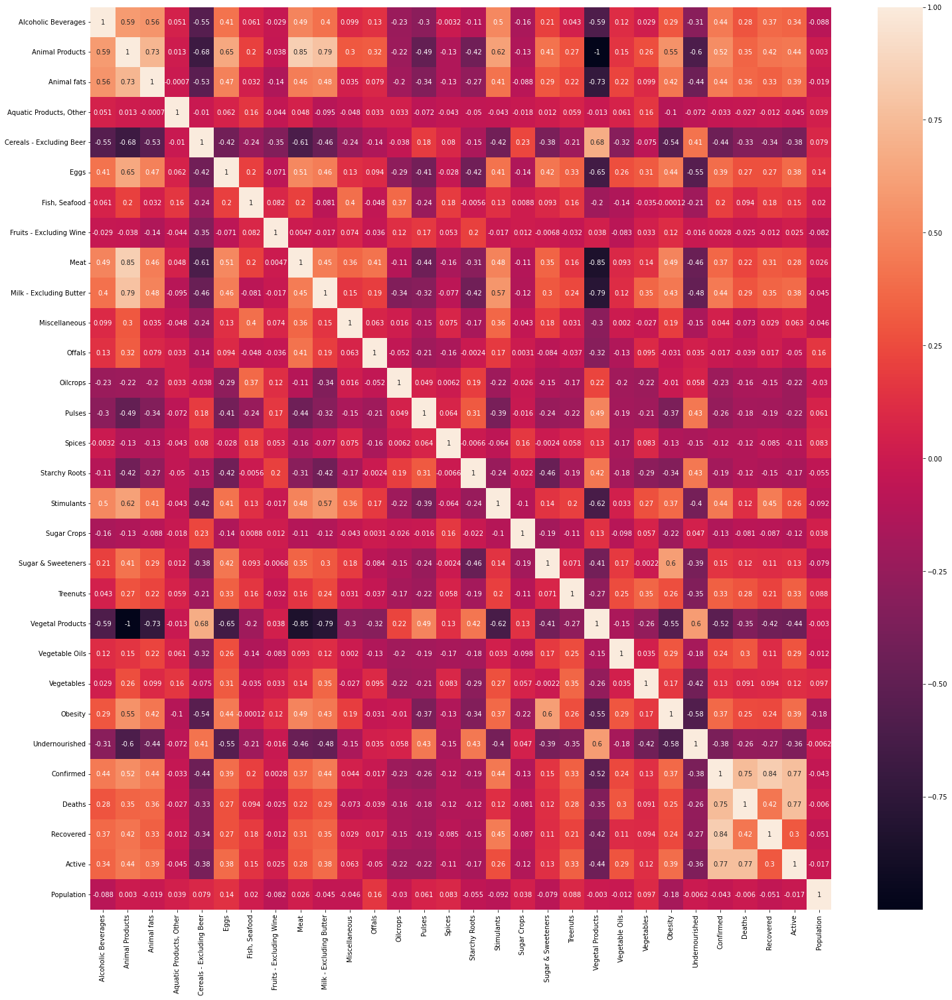

In [13]:
# Correlation Matrix (Works Only for Regression Variables)
fig, ax = plt.subplots(figsize=(25,25)) 
corrMatrix = food_supply_kcal_data.corr()
sns.heatmap(corrMatrix, annot=True, ax=ax)
plt.show()

In [14]:
# List of ALL Health Diet Intakes 
health_diet_intakes = ['Alcoholic Beverages', 'Animal Products', 'Animal fats', 'Aquatic Products, Other', 'Cereals - Excluding Beer', 'Eggs', 'Fish, Seafood', 'Fruits - Excluding Wine', 
                       'Meat', 'Miscellaneous', 'Milk - Excluding Butter', 'Offals', 'Oilcrops', 'Pulses', 'Spices', 'Starchy Roots', 'Stimulants', 'Sugar Crops', 'Sugar & Sweeteners',
                       'Treenuts', 'Vegetal Products', 'Vegetable Oils', 'Vegetables']

Relationship Between ALL Health Diet Food Intakes (in kcal) Percentage and Obesity Percentage

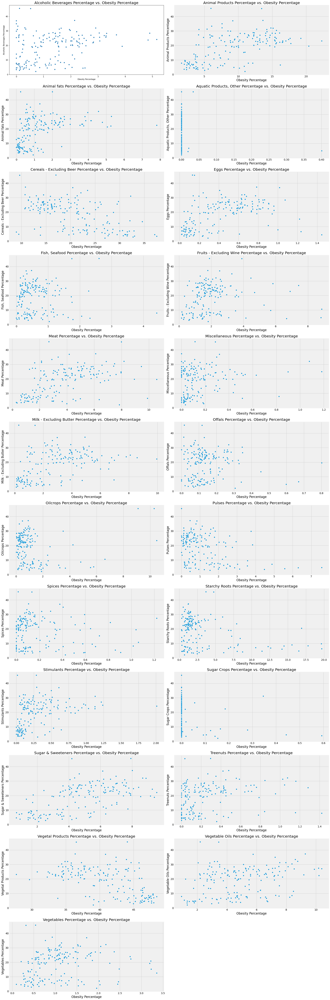

In [15]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Obesity', 
            data = food_supply_kcal_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Obesity Percentage"
  x_title = "Obesity Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kcal) Percentage and Undernourished Percentage

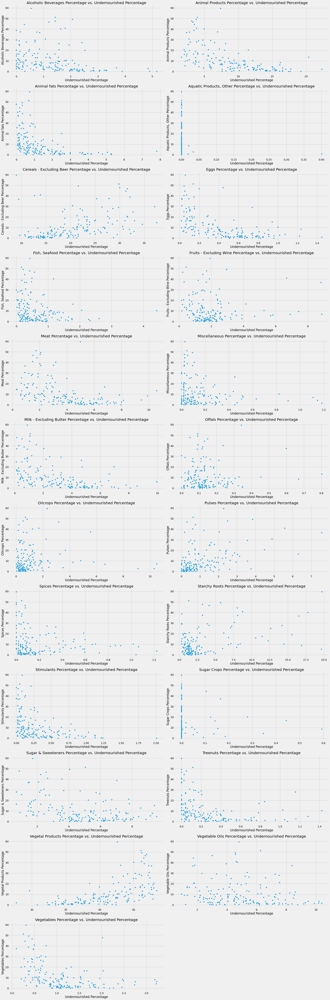

In [17]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Undernourished', 
            data = food_supply_kcal_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Undernourished Percentage"
  x_title = "Undernourished Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kcal) Percentage and Confirmed Cases of COVID-19 Percentage

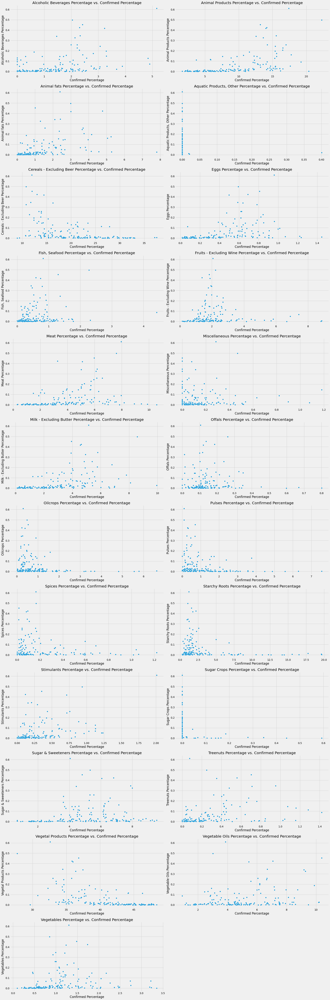

In [18]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Confirmed', 
            data = food_supply_kcal_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Confirmed Percentage"
  x_title = "Confirmed Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kcal) Percentage and Death from COVID-19 Percentage

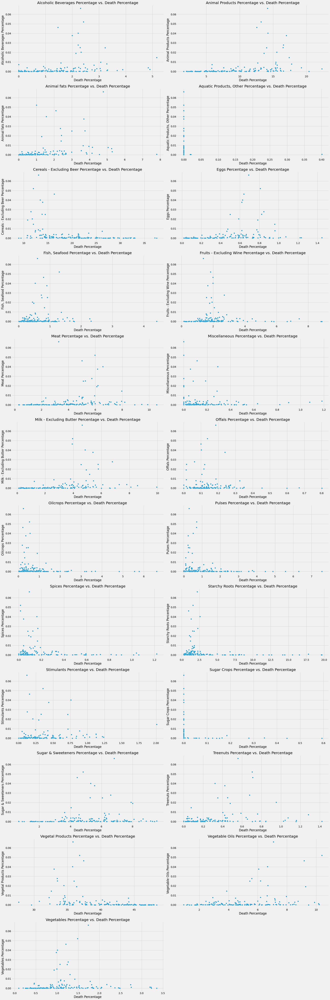

In [19]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Deaths', 
            data = food_supply_kcal_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Death Percentage"
  x_title = "Death Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kcal) Percentage and Recovery from COVID-19 Percentage

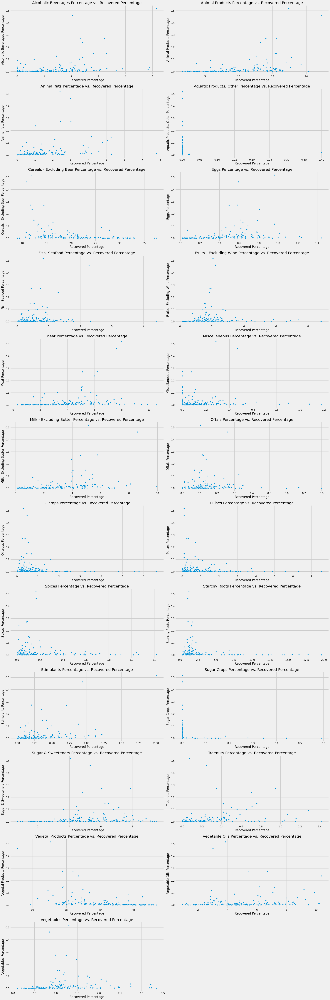

In [20]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Recovered', 
            data = food_supply_kcal_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Recovered Percentage"
  x_title = "Recovered Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Relationship Between ALL Health Diet Food Intakes (in kcal) Percentage and Active Cases of COVID-19 Percentages

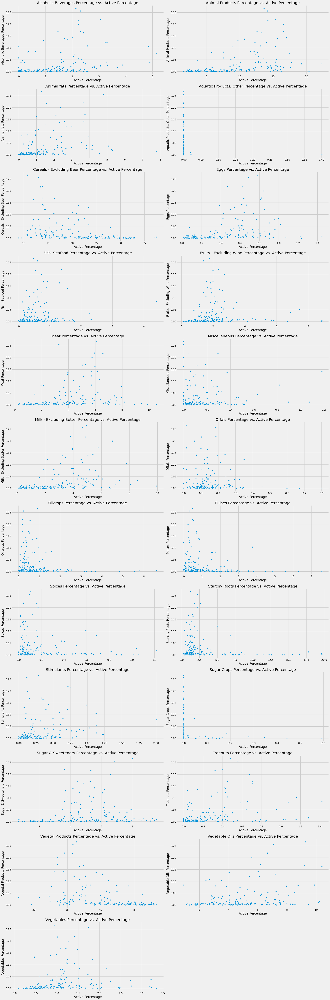

In [21]:
a = 12  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(25,75))
for intake in health_diet_intakes:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = intake, y = 'Active', 
            data = food_supply_kcal_data)
  style.use('fivethirtyeight')
  title = intake + " Percentage vs. Active Percentage"
  x_title = "Active Percentage"
  y_title = intake + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Obesity Percentages and ALL of Confirmed, Death, Recovered, and Active Cases of COVID-19 Percentages

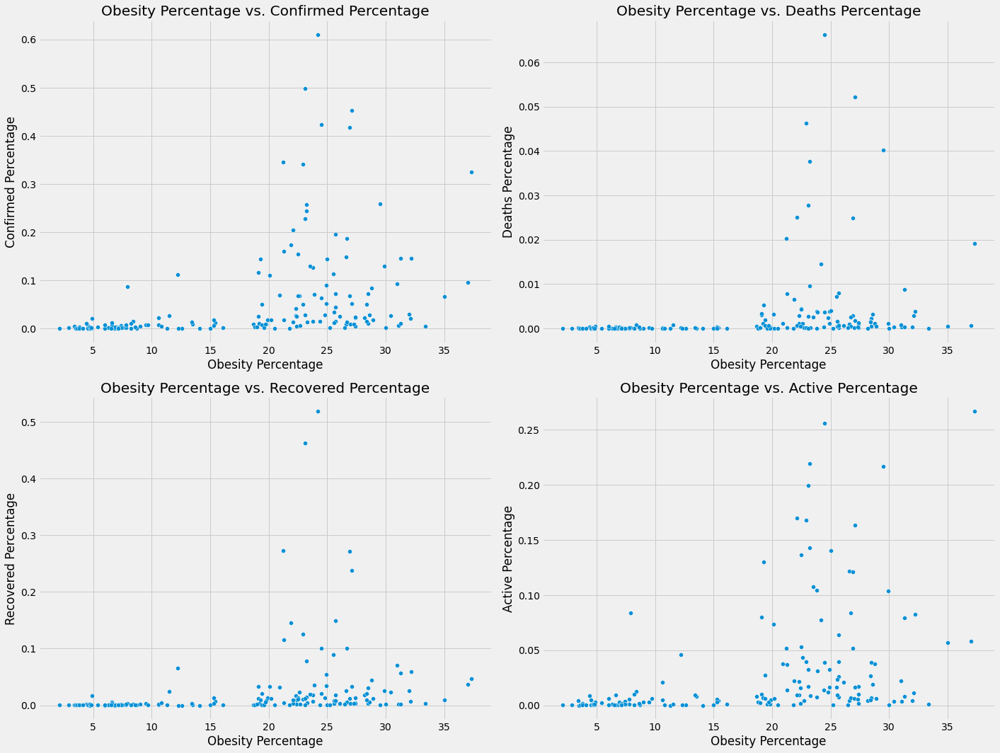

In [22]:
a = 2  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(20,15))
for target in ['Confirmed', 'Deaths', 'Recovered', 'Active']:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = 'Obesity', y = target, 
            data = food_supply_kcal_data)
  style.use('fivethirtyeight')
  title = "Obesity Percentage vs. " + target + " Percentage"
  x_title = "Obesity Percentage"
  y_title = target + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Undernourished Percentages and ALL of Confirmed, Death, Recovered, and Active Cases of COVID-19 Percentages

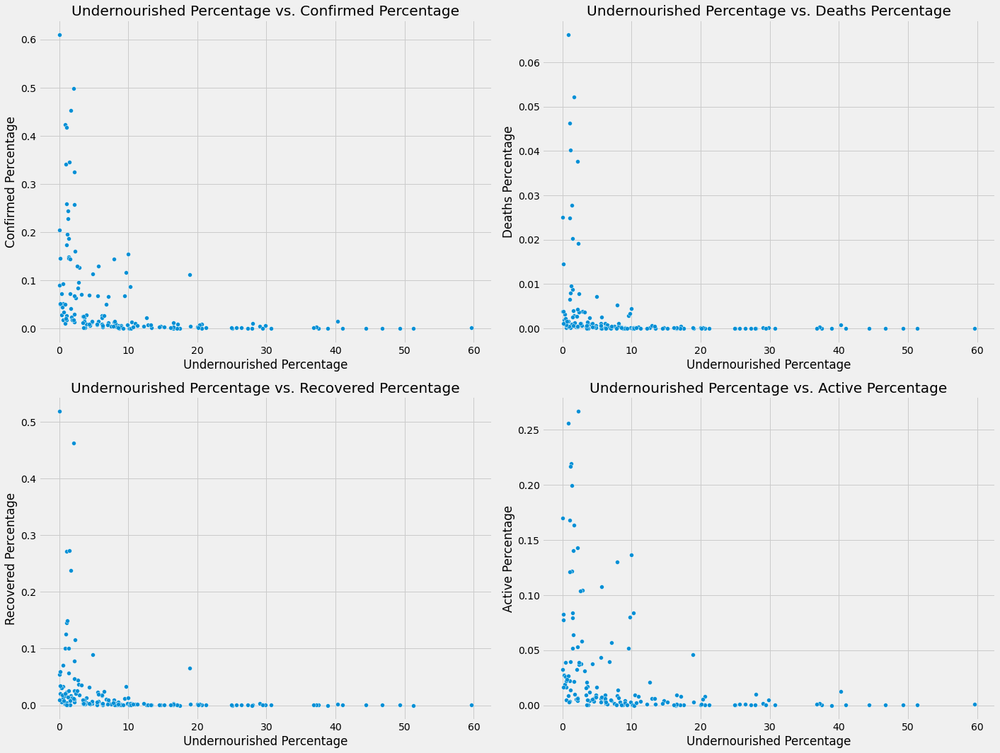

In [23]:
a = 2  # number of rows
b = 2  # number of columns
c = 1  # initialize plot counter

fig = plt.figure(figsize=(20,15))
for target in ['Confirmed', 'Deaths', 'Recovered', 'Active']:
  plt.subplot(a, b, c)
  fig.tight_layout()
  sns.scatterplot(x = 'Undernourished', y = target, 
            data = food_supply_kcal_data)
  style.use('fivethirtyeight')
  title = "Undernourished Percentage vs. " + target + " Percentage"
  x_title = "Undernourished Percentage"
  y_title = target + " Percentage"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  c = c + 1
plt.show()

Confirmed Cases of COVID-19 Percentages Between Countries

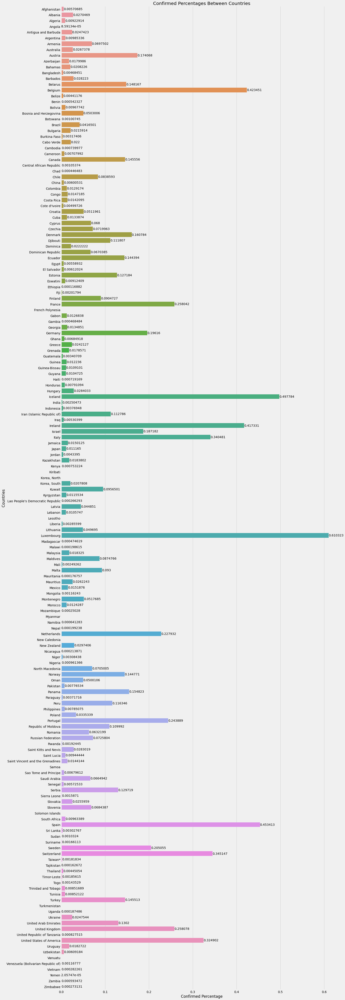

In [25]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Confirmed', y = 'Country', data = food_supply_kcal_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Confirmed Percentages Between Countries"
plt.title(title)
plt.xlabel("Confirmed Percentage")
plt.ylabel("Countries")
plt.show()

Death from COVID-19 Percentages Between Countries

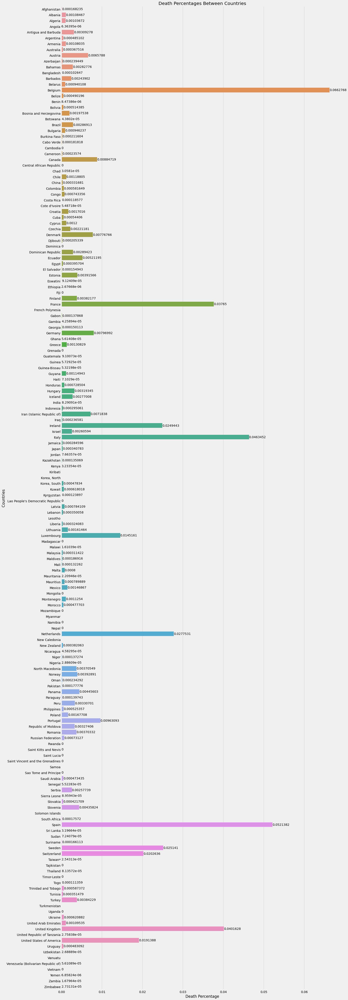

In [26]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Deaths', y = 'Country', data = food_supply_kcal_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Death Percentages Between Countries"
plt.title(title)
plt.xlabel("Death Percentage")
plt.ylabel("Countries")
plt.show()

Recovered from COVID-19 Percentages Between Countries

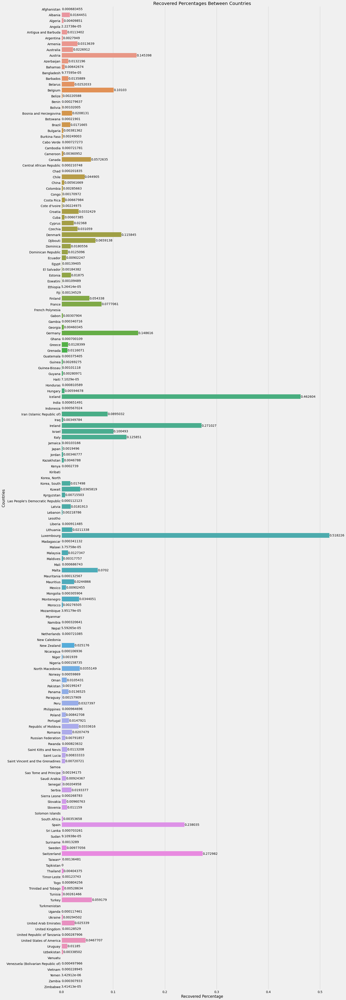

In [27]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Recovered', y = 'Country', data = food_supply_kcal_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Recovered Percentages Between Countries"
plt.title(title)
plt.xlabel("Recovered Percentage")
plt.ylabel("Countries")
plt.show()

Active Cases of COVID-19 Percentages Between Countries

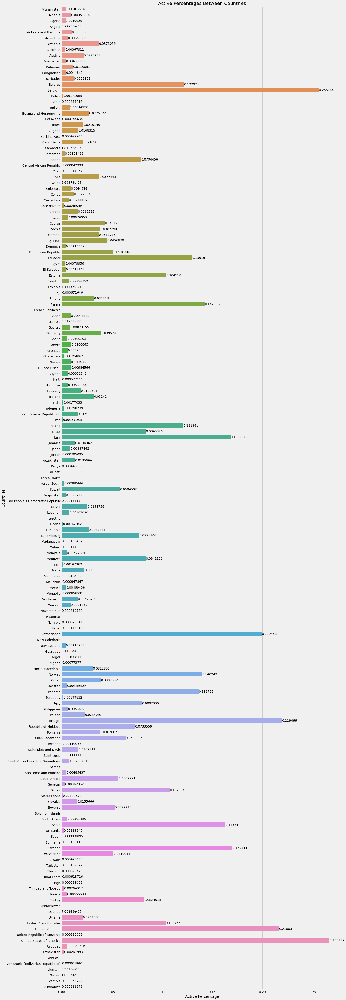

In [28]:
fig, ax = plt.subplots(figsize=(20, 75))
sns.barplot(x = 'Active', y = 'Country', data = food_supply_kcal_data, capsize = 0.2, orient = 'h', ax = ax)
ax.bar_label(ax.containers[-1], label_type='edge')
style.use('fivethirtyeight')
title = "Active Percentages Between Countries"
plt.title(title)
plt.xlabel("Active Percentage")
plt.ylabel("Countries")
plt.show()

ALL Health Diet Food Intakes (in kcal) Percentages Between Countries

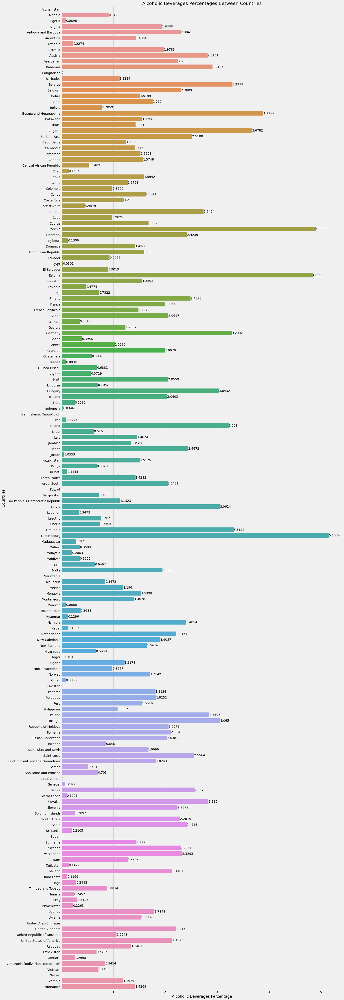

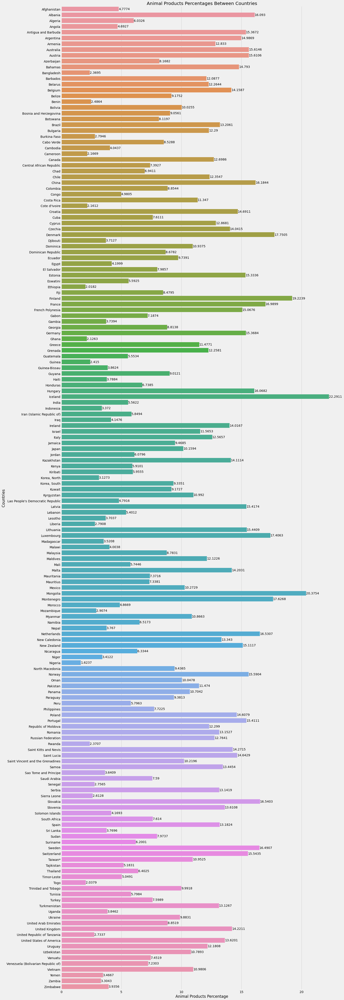

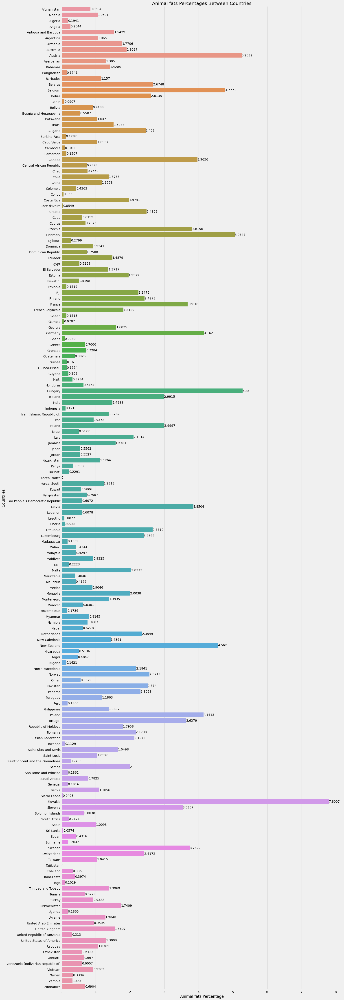

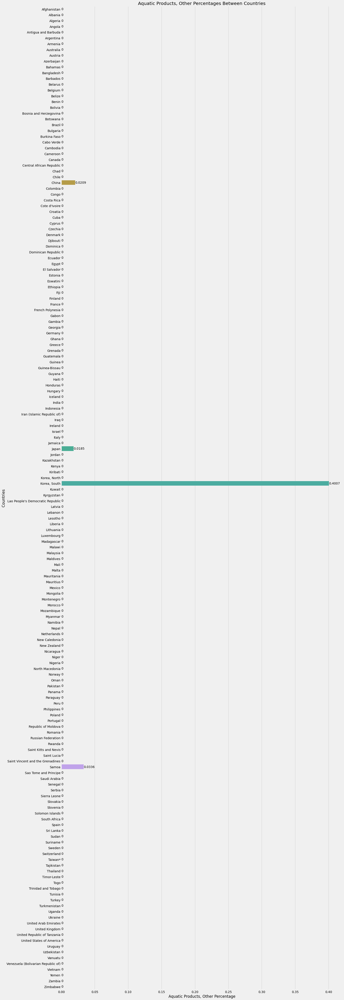

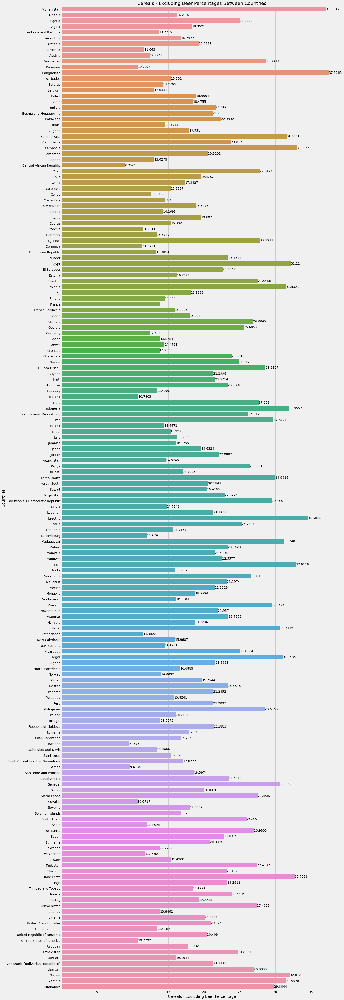

...

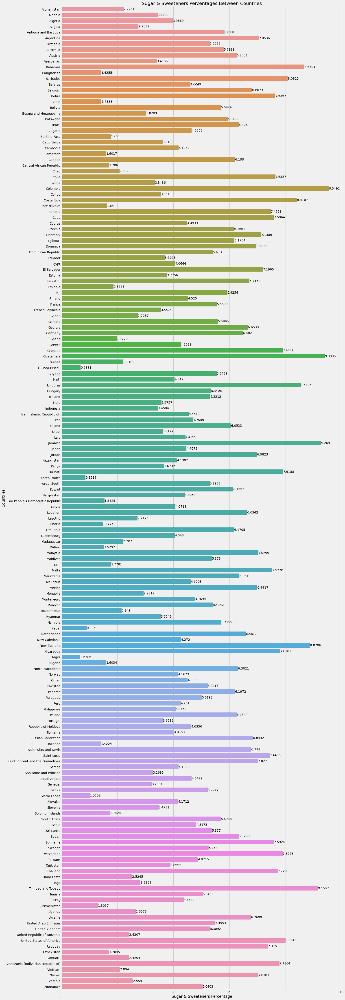

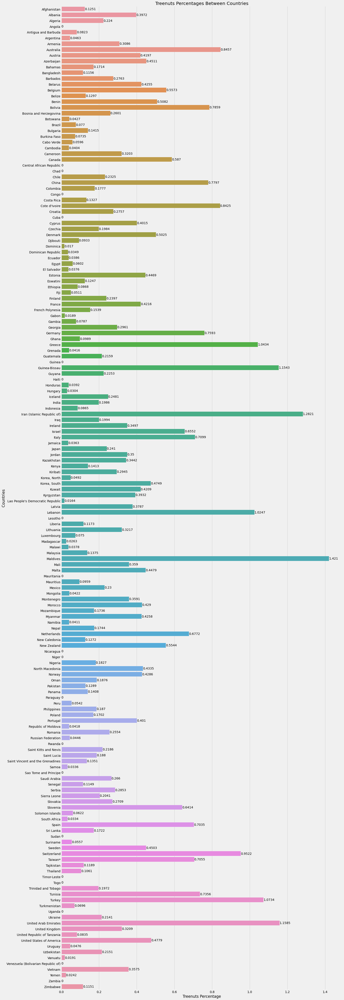

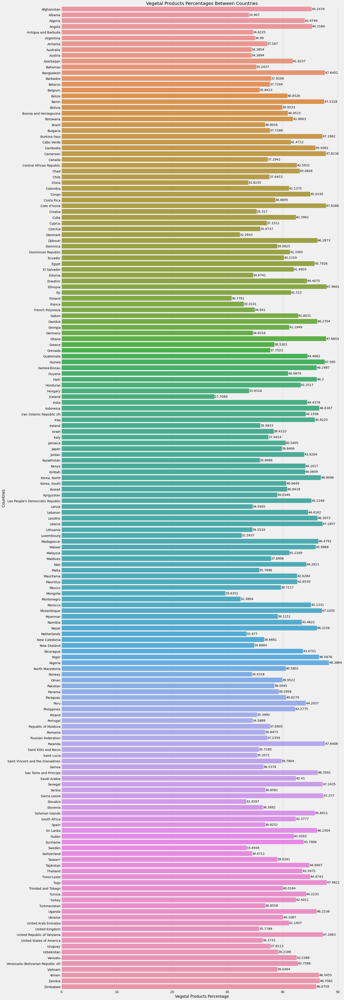

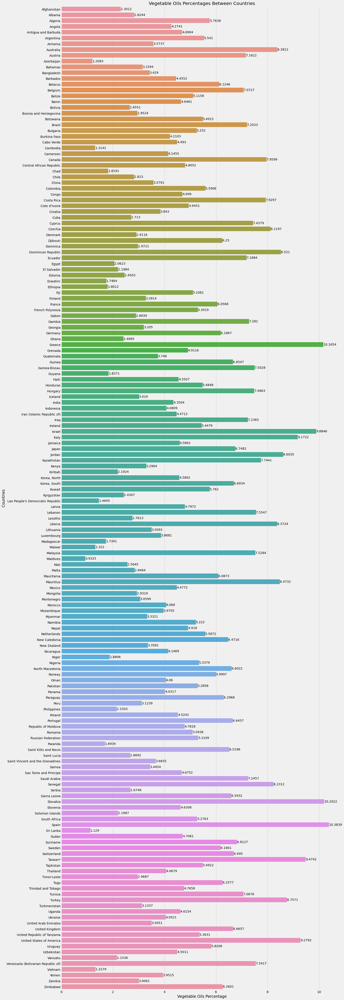

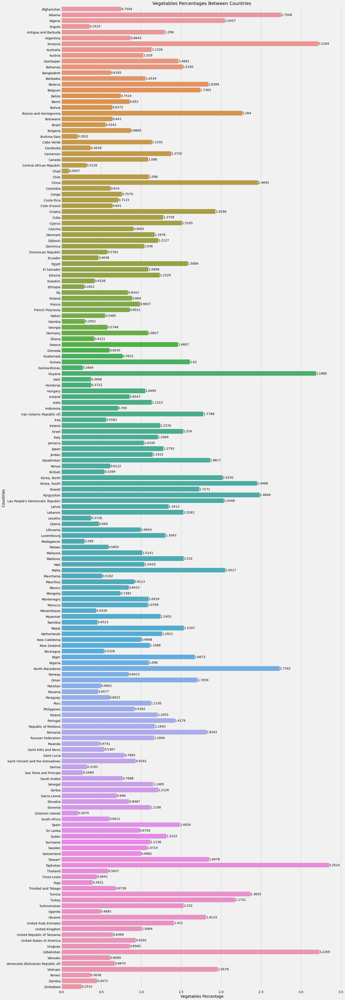

In [29]:
for intake in health_diet_intakes:
  fig, ax = plt.subplots(figsize=(20, 75))
  sns.barplot(x = intake, y = 'Country', data = food_supply_kcal_data, capsize = 0.2, orient = 'h', ax = ax)
  ax.bar_label(ax.containers[-1], label_type='edge')
  style.use('fivethirtyeight')
  title = intake + " Percentages Between Countries"
  x_title = intake + " Percentage"
  y_title = "Countries"
  plt.xlabel(x_title)
  plt.ylabel(y_title)
  plt.title(title) 
  plt.show()
  print("          ")
  print("          ")